# **K Means Clustering**

- K-mean Clustering  is a type of unsupervised machine learning
- It works on an unlabeled data
- It makes clusters from the unlabeled data 

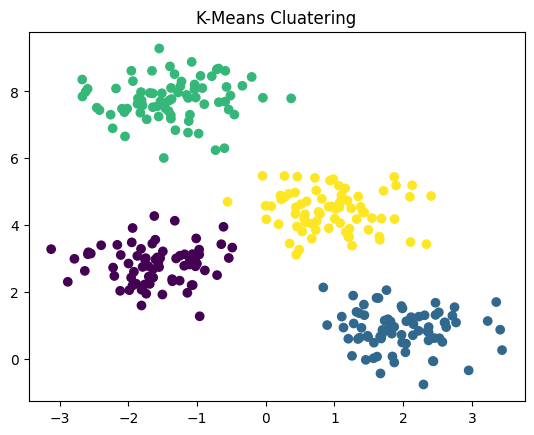

In [4]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt


X , y_true = make_blobs(n_samples=300 , centers=4 , cluster_std=0.6 , random_state=0)

kmeans = KMeans(n_clusters=4)
kmeans.fit(X)

labels = kmeans.labels_

plt.scatter(X[: , 0] , X[: , 1] , c=labels)
plt.title('K-Means Cluatering')
plt.show()


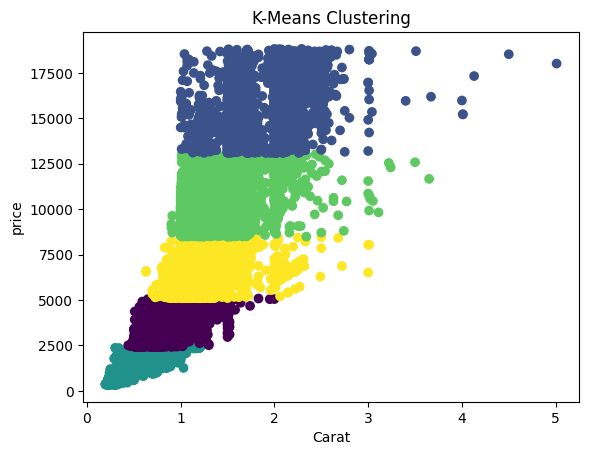

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans


df = sns.load_dataset('diamonds')

X = df[['carat' , 'price']]

kmeans = KMeans(n_clusters=5)
kmeans.fit(X)

labels = kmeans.labels_
df['Labels'] = labels

plt.scatter(X.iloc[: , 0] , X.iloc[: , 1] , c=labels)
plt.xlabel('Carat')
plt.ylabel('price')
plt.title('K-Means Clustering')
plt.show()

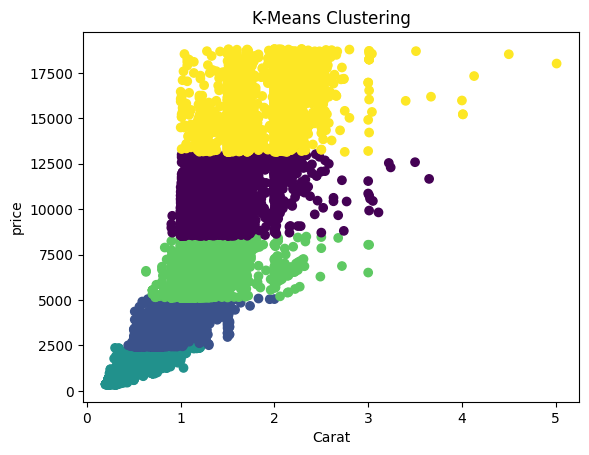

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans


df = sns.load_dataset('diamonds')

X = df[['carat' , 'price' , 'cut' , 'color' , 'clarity']]
X = pd.get_dummies(X)

kmeans = KMeans(n_clusters=5)
kmeans.fit(X)

labels = kmeans.labels_
df['Labels'] = labels

plt.scatter(X.iloc[: , 0] , X.iloc[: , 1] , c=labels)
plt.xlabel('Carat')
plt.ylabel('price')
plt.title('K-Means Clustering')
plt.show()

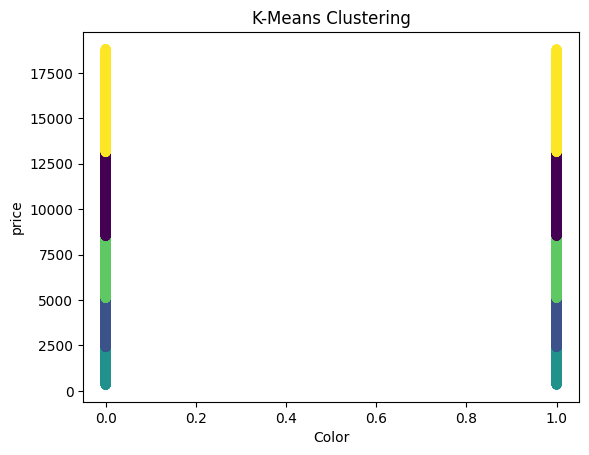

In [7]:
plt.scatter(X.iloc[: , 2] , X.iloc[: , 1] , c=labels)
plt.xlabel('Color')
plt.ylabel('price')
plt.title('K-Means Clustering')
plt.show()

In [8]:
import plotly.express as px

fig = px.parallel_coordinates(df , color=labels)
fig.show()

# **Model Evaluation**

1. **Elbow Method**

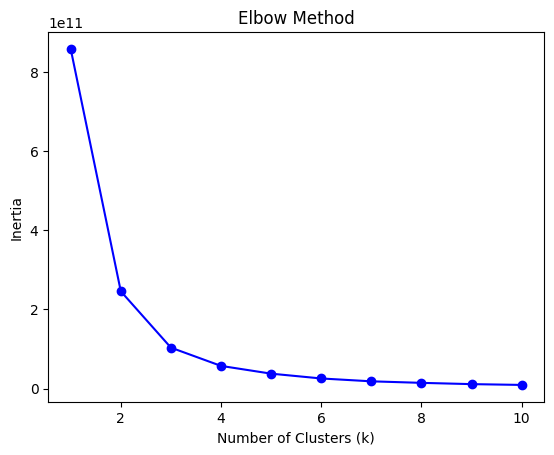

In [9]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering for different values of k
k_values = range(1, 11)  # Test k from 1 to 10
inertias = []  # List to store the inertia values

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

# Plot the Elbow curve
plt.plot(k_values, inertias, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

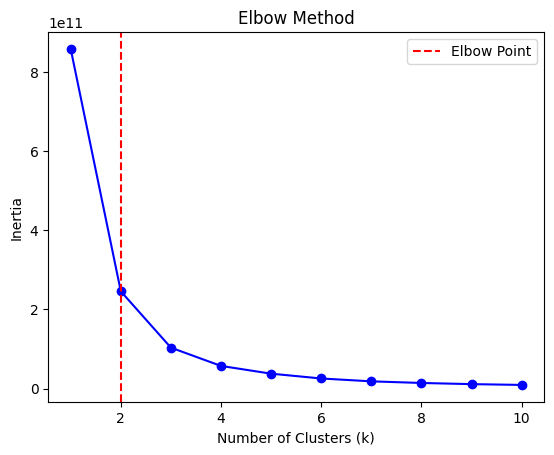

The best number of clusters based on the Elbow Method is: 2


In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering for different values of k
k_values = range(1, 11)  # Test k from 1 to 10
inertias = []  # List to store the inertia values

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

# Plot the Elbow curve
plt.plot(k_values, inertias, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')

# Find the elbow point
diff = [inertias[i] - inertias[i+1] for i in range(len(inertias)-1)]
best_k = diff.index(max(diff)) + 2

# Add a vertical line to indicate the elbow point
plt.axvline(x=best_k, color='r', linestyle='--', label='Elbow Point')

plt.legend()
plt.show()

print("The best number of clusters based on the Elbow Method is:", best_k)

**Other evaluation methods**
- Silhouette Score
- Calinski-Harabasz
- Davies-Bouldin
- Silhouette
- Gap statistic
- Bayesian information criterion (BIC)

# **K-means++**
The main difference between K-means and K-means++ lies in the initialization of cluster centroids. The standard K-means algorithm initializes centroids randomly, while K-means++ improves this initialization by selecting centroids in a more strategic and probabilistic manner. Here are the key distinctions:

## **Centroid Initialization:**

- K-means: In the original K-means algorithm, centroids are initialized randomly from the available data points.
- K-means++: The K-means++ algorithm initializes the first centroid randomly, but subsequent centroids are chosen based on the distances to previously selected centroids. Data points farther away from existing centroids have a higher probability of being chosen.

## **Impact on Clustering Results:**

- K-means: The random initialization in K-means can lead to different clusterings each time the algorithm is run. It is more sensitive to the initial placement of centroids, and there is a higher chance of converging to suboptimal solutions.
- K-means++: By strategically initializing centroids, K-means++ mitigates the sensitivity to initialization. It encourages a more spread-out initialization, which typically leads to better cluster formation and more reliable results. K-means++ tends to produce more stable and consistent clusters across different runs.

## **Convergence and Efficiency:**

- K-means: The random initialization in K-means may require more iterations to converge, as the initial centroids might be far from their optimal positions. It can result in slower convergence and higher computational costs.
- K-means++: The improved initialization in K-means++ often leads to faster convergence since the initial centroids are better positioned. It reduces the number of iterations required to achieve convergence and can improve the algorithm's efficiency.
- Overall, K-means++ is a modification of the standard K-means algorithm that provides a more effective and robust initialization scheme. By selecting initial centroids strategically, it enhances the quality of the clustering results and reduces sensitivity to the initial random initialization. K-means++ is widely used in practice as it improves the performance and stability of the K-means clustering algorithm.

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering with K-means++
k = 3  # Number of clusters
kmeans_pp = KMeans(n_clusters=k, init='k-means++', random_state=42)
kmeans_pp.fit(X)

# Perform standard K-means clustering
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(X)

# Add cluster labels to the dataset
df['cluster_pp'] = kmeans_pp.labels_
df['cluster'] = kmeans.labels_

df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,cluster_pp,cluster
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,1,1
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,1,1
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,1,1
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,1,1
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,1,1


In [12]:
df.cluster.value_counts()

cluster
1    32851
2    15374
0     5715
Name: count, dtype: int64

In [13]:
df.cluster_pp.value_counts()


cluster_pp
1    32851
2    15374
0     5715
Name: count, dtype: int64

In [14]:
import plotly.express as px
fig = px.scatter(df, x='carat', y='price', color='cluster_pp')
fig.show()

In [15]:
# make a 3d plot in plotly
fig = px.scatter_3d(df, x='carat', y='depth', z='price', color='cluster_pp')
fig.show()

In [16]:
fig = px.parallel_coordinates(df, color='cluster_pp')
fig.show()